In [2]:
import numpy as np
import matplotlib.pyplot as plt
import math as m
import scipy.stats as st
from scipy.stats import linregress

# Ferromagnetic Hysteresis
Lab performed February 14, 2024 by Ben Roytblat and Noah Warren part of ENPH 253 course

The purpose of the lab is to determine the magnetic hysteresis curves of two different ferromagnetic materials, transformer iron and carbon steel.

###  Apparatus

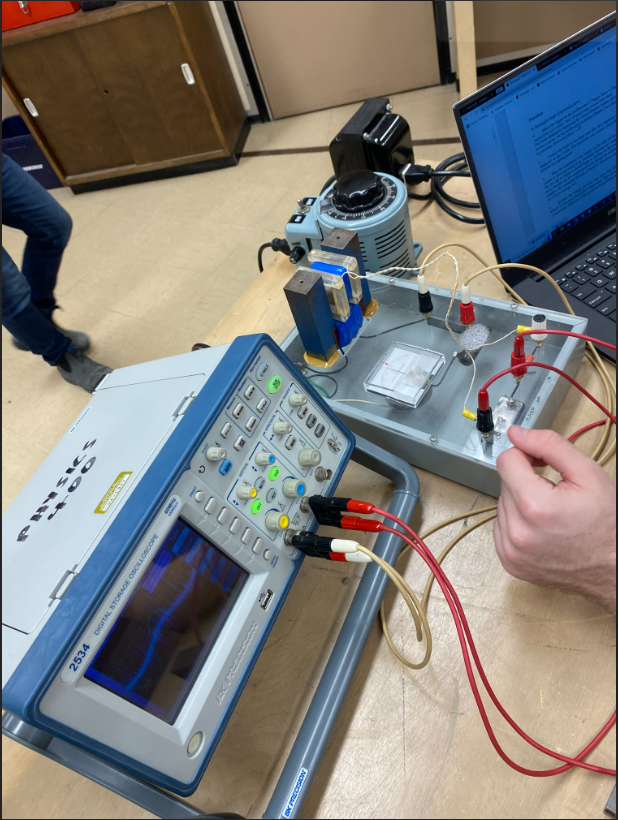

Oscilloscope: BK Precision 2534 Digital Storage Oscilloscope 60MHz 400MSa/s
10th of a division error
150 turn coil wire
variable voltage supply error within +/- 0.5V

# Experiment
An oscilloscope is used to examine hysteresis loops for the iron and steel. The circuit diagram of the apparatus is shown below. The material under test is made a part of the ferromagnetic core of a transformer. 
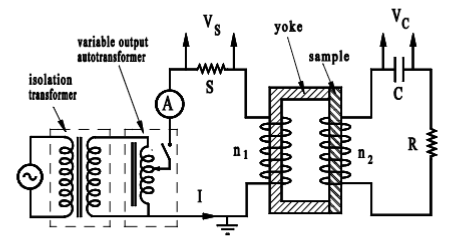

# Starting Lab measurements


## Part A: Investigate shape of hysteresis curve

### Procedure - Part 1
We adjusted the trigger on the oscilloscope to be of type edge, and the to be AC Line which is the signal from wall outlet.
we then zeroed both channels by depressing the Vertical Position buttons and check that both channels are set for x1 probe. The oscilloscope was set to display Channel 2 as a function of Channel 1 (XY Mode)
### Procedure - Part 2
Connected the leads to the scope such that H was displayed on the X-axis and the B-field is displayed on the Y-axis.
### Procedure - Part 3
Placed the transformer iron sample on the yoke, set the variable variac control to zero and switched it on. We gradually increased the voltage on the variac.
A hysteresis loop began to develop on the screen. The signal was very noisy but was compensated for by having the oscilloscope average the signal over many
samples.
The average function was found through the mode being set to average, set number of cycles to average over.
### Procedure - Part 4
We increased the voltage until the loop spanned four divisions of the horizontal axis. 
This corresponds to a magnetization current of 4 Amps peak.
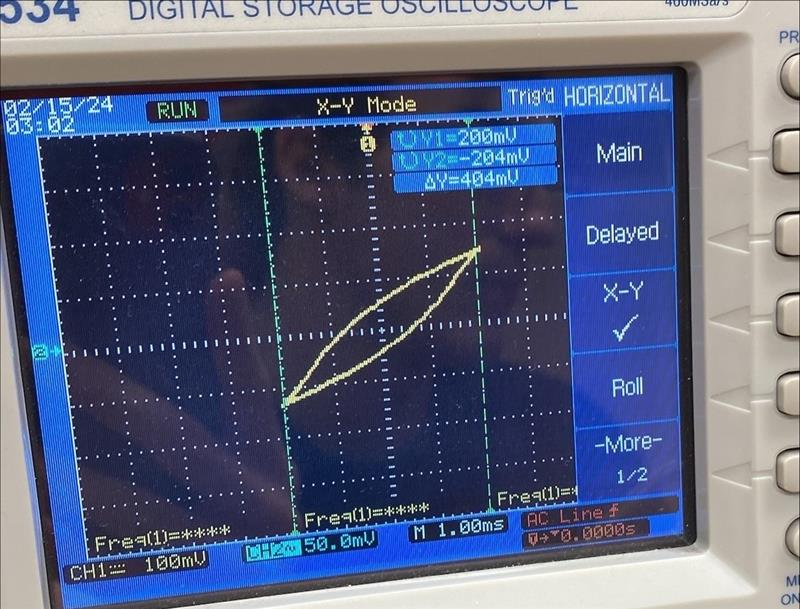
### Procedure - Part 5
We switched the oscilliscope back to time domain and adjusted the time resolution so that the display shows 5ms per division
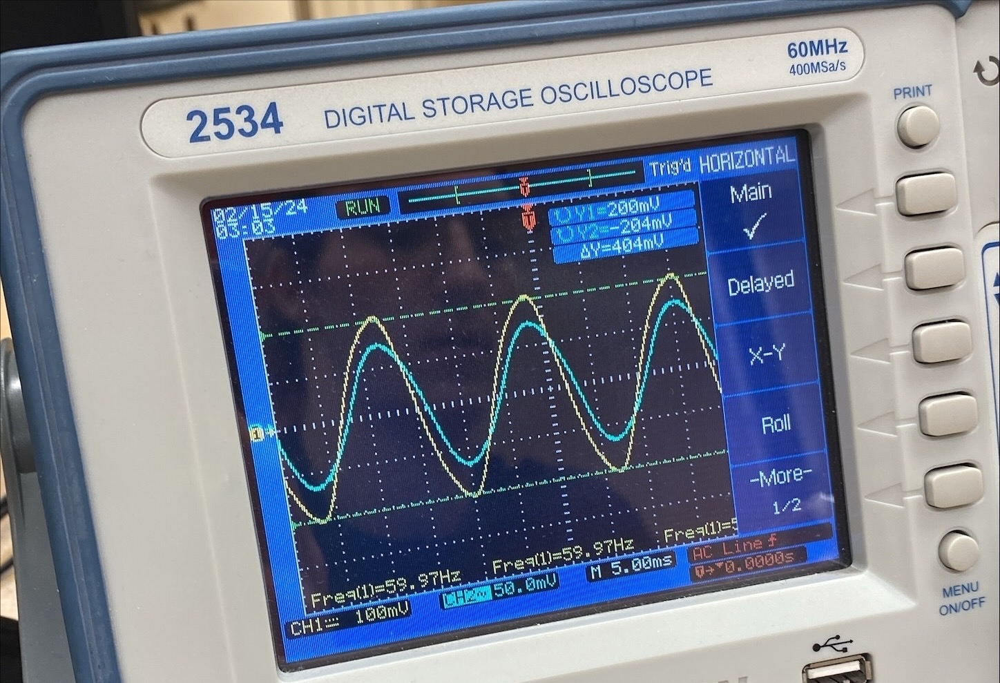
### Procedure - Part 6
We collected a csv file of the waveform.

## Part B: Investigate initial magnetization curve

### Procedure - Part 7
We returned the display to XY mode. Starting from zero, we gradually increased the variac voltage while recording the progression of the upper right corner of the hysteresis loop. The measurements were made using the oscilloscope cursors


the error of the oscilloscope divisions was determined based on resolution of the cursor. we did +/- 1 increment per cursor and it changes since the scale is changing aswell.

the variac voltage source only gives a percentage of the voltage from the wall (115V) so we think we can get within half a percent

through observation, we assumed that the resistor is dissipating roughly a watt

The table below shows the reading of the iron sample
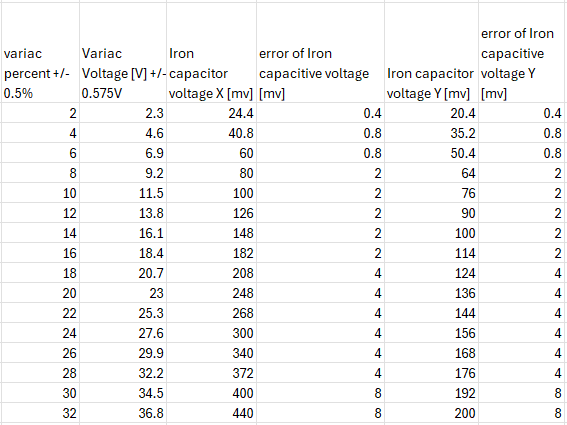


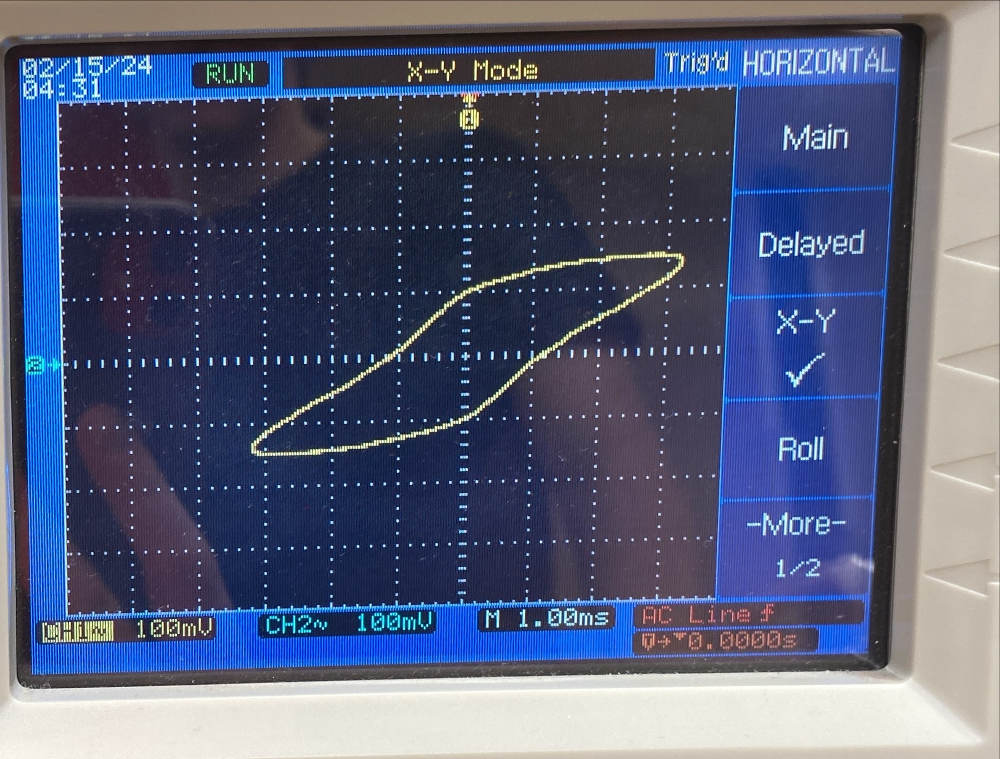

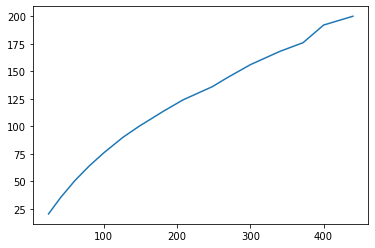

In [3]:
#of steel
variacVoltage = np.array([1,2,3,4,5,6,7,8,10,12,14,16,18,20,22,24,26,28,30])
variacError = 0.5
steelCapacitorVoltage = np.array([44,64,78,100,114,130,144,160,182,208,228,244,264,280,304,328,352,376,400]) #in millivolts
steelCapacitorVoltageError = np.array([1,1,2,2,2,2,2,2,4,4,4,4,4,4,4,4,4,8]) #in millivolts


#of iron
variacVoltage2 = np.array([2,4,6,8,10,12,14,16,18,20,25,30,35,40,45,50])
variacError = 0.5
ironCapacitorVoltageBad = np.array([15.6,20,24,28,32.8,37.2,43.2,49.6,56,63.2,90,122,170,252,380]) #in millivolts
ironCapacitorVoltageErrorBad = np.array([0.4,0.4,0.4,0.4,0.4,0.4,0.8,0.8,0.8,2,2,2,4,4,8]) #in millivolts

ironCapacitorVoltageX = np.array([24.4,40.8,60,80,100,126,148,182,208,248,268,300,340,372,400,440])

ironCapacitorVoltageY = np.array([20.4,35.2,50.4,64,76,90,100,114,124,136,144,156,168,176,192,200])
ironCapacitorVoltageErrorX = np.array([0.4,0.8,0.8,2,2,2,2,4,4,4,4,4,8,8])
ironCapacitorVoltageErrorY = np.array([0.4,0.8,0.8,2,2,2,2,4,4,4,4,4,8,8])

plt.plot(ironCapacitorVoltageX, ironCapacitorVoltageY)

[0.168, 0.168, 0.16, 0.152, 0.152, 0.152, 0.144, 0.136, 0.136, 0.128, 0.128, 0.12, 0.12, 0.12, 0.12, 0.112, 0.112, 0.104, 0.096, 0.096, 0.096, 0.088, 0.088, 0.088, 0.088, 0.072, 0.08, 0.08, 0.072, 0.072, 0.072, 0.056, 0.056, 0.056, 0.056, 0.056, 0.048, 0.056, 0.048, 0.048, 0.048, 0.04, 0.04, 0.032, 0.032, 0.032, 0.032, 0.032, 0.024, 0.024, 0.024, 0.016, 0.016, 0.016, 0.016, 0.016, 0.008, 0.016, 0.008, 0.008, 0.008, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.008, 0.0, 0.0, 0.0, 0.0, -0.008, -0.008, -0.008, -0.008, -0.008, -0.008, -0.008, -0.016, -0.008, -0.016, -0.016, -0.016, -0.016, -0.016, -0.024, -0.024, -0.016, -0.024, -0.024, -0.024, -0.024, -0.024, -0.024, -0.024, -0.024, -0.024, -0.032, -0.032, -0.032, -0.032, -0.032, -0.032, -0.032, -0.032, -0.032, -0.032, -0.04, -0.04, -0.04, -0.032, -0.032, -0.04, -0.032, -0.04, -0.04, -0.04, -0.04, -0.048, -0.04, -0.04, -0.048, -0.04, -0.04, -0.048, -0.048, -0.048, -0.048, -0.048, -0.048, -0.048, -0.048, -0.056, -0.048, -0.056, -0.056, -0.056, -0

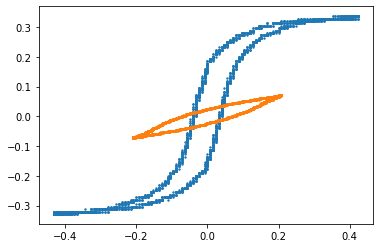

In [4]:
import pandas as pd

# Replace 'your_file.csv' and 'your_column_name' with the actual path and column name
df = pd.read_csv(r'C:\Users\ben\Desktop\Queens Year 2\Semester 2\ENPH 253\File1HysteresisIRON.CSV')
# column_list = df['A'].tolist()
ironA = df.iloc[0:,0].tolist()
ironA.pop(0)
ironColumnA = list(map(float, ironA))

ironB = df.iloc[0:,1].tolist()
ironB.pop(0)
ironColumnB = list(map(float, ironB))

ironC = df.iloc[0:,2].tolist()
ironC.pop(0)
ironColumnC = list(map(float, ironC))


# Replace 'your_file.csv' and 'your_column_name' with the actual path and column name
df1 = pd.read_csv(r'C:\Users\ben\Desktop\Queens Year 2\Semester 2\ENPH 253\File2HysteresisSteel.CSV')
# column_list = df['A'].tolist()


steelA = df1.iloc[0:,0].tolist()
steelA.pop(0)
steelColumnA = list(map(float, steelA))

steelB = df1.iloc[0:,1].tolist()
steelB.pop(0)
steelColumnB = list(map(float, steelB))

steelC = df1.iloc[0:,2].tolist()
steelC.pop(0)
steelColumnC = list(map(float, steelC))
# Display the resulting list

plt.scatter(ironColumnB, ironColumnC, s=2)
plt.scatter(steelColumnB, steelColumnC, s=2)


print(ironColumnB)

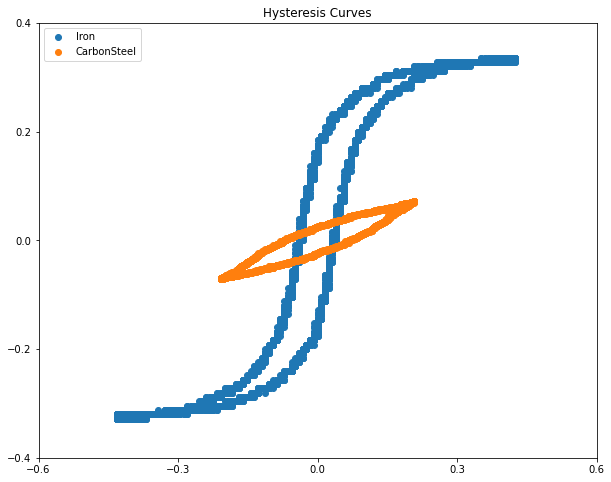

In [5]:
# Plots


plt.figure(figsize=(10,8))

plt.scatter(ironColumnB, ironColumnC, label="Iron")
plt.scatter(steelColumnB, steelColumnC, label="CarbonSteel")


plt.title("Hysteresis Curves")
plt.xlabel("")
plt.ylabel("")
# plt.xlim(-0.5,0.5)
# plt.ylim(-0.5,0.5)
# plt.axis([-6e-01, 6e01, -4e-01, 0.4e01])
plt.xticks(np.linspace(-0.6, 0.6, 5))
plt.yticks(np.linspace(-0.4, 0.4, 5))


plt.legend()

plt.show()


# print(f"Resistance: {linReg1[1]}, Inductance: {linReg1[0]}")

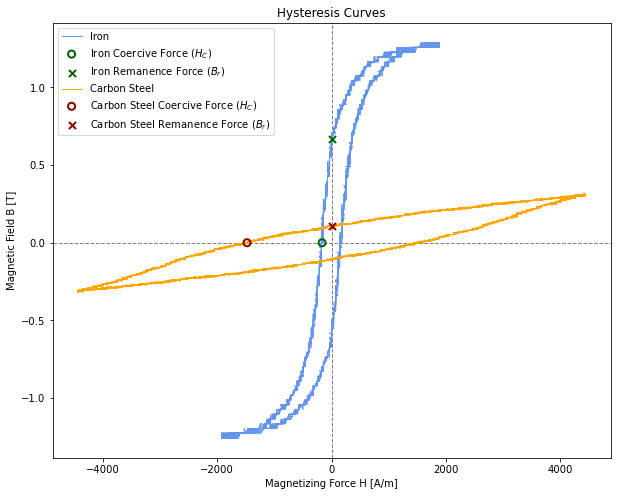

In [6]:
# Plots
n1 = 160
n2 = 150
s = 0.1

ironL = 0.36
ironAc = 0.00087

steelL = 0.075
steelAc = 0.00076

R = 1e6
C = 5e-10

ironH = [n1 * value / (ironL * s) for value in ironColumnB]
ironB = [R * C * value *1000/ (n2 * ironAc) for value in ironColumnC]
steelH = [n1 * value/ (steelL * s) for value in steelColumnB]
steelB = [R * C * value *1000/ (n2 * steelAc) for value in steelColumnC]

plt.figure(figsize=(10,8))

plt.axvline(x=0, color='grey', linestyle='--', linewidth=1)
plt.axhline(y=0, color='grey', linestyle='--', linewidth=1)


plt.plot(ironH, ironB, label="Iron", linewidth=1, color='cornflowerblue')
plt.scatter(-166,0, label='Iron Coercive Force ($H_C$)', marker='o', facecolor='none', color='darkgreen',linewidth = 2, s=50, zorder=2)
plt.scatter(0,0.67, label='Iron Remanence Force ($B_r$)', marker='x', color='darkgreen',linewidth = 2, s=50, zorder=2)

plt.plot(steelH, steelB, label="Carbon Steel", linewidth=1, color='orange')
plt.scatter(-1479.11,0, label='Carbon Steel Coercive Force ($H_C$)', marker='o', facecolor='none', color='darkred',linewidth = 2, s=50, zorder=2)
plt.scatter(0,0.11023, label='Carbon Steel Remanence Force ($B_r$)', marker='x', color='darkred',linewidth = 2, s=50, zorder=2)

plt.title("Hysteresis Curves")
plt.xlabel("Magnetizing Force H [A/m]")
plt.ylabel("Magnetic Field B [T]")
# plt.xlim(-0.5,0.5)
# plt.ylim(-0.5,0.5)
# plt.axis([-6e-01, 6e01, -4e-01, 0.4e01])
# plt.xticks(np.linspace(-0.6, 0.6, 5))
# plt.yticks(np.linspace(-0.4, 0.4, 5))


plt.legend()

plt.show()


# print(f"Resistance: {linReg1[1]}, Inductance: {linReg1[0]}")

### Procedure - Part 8
we repeated steps 3 to 6 for the carbon steel sample

In [7]:
import numpy as np
from scipy.integrate import simps

# Assuming you have loaded your hysteresis data into arrays x and y
# x represents the horizontal axis, and y represents the vertical axis

# Calculate the area using the trapezoidal rule
area_trapz = np.trapz(steelH, steelB)




print("Area using Trapezoidal Rule:", area_trapz)


Area using Trapezoidal Rule: 7205.0526315789475


In [8]:


def trapezoidal_error_hysteresis(x, y):
    """
    Calculate the error of the trapezoidal rule approximation for hysteresis data.

    Parameters:
    - x: List or array of x-values.
    - y: List or array of y-values.

    Returns:
    - error: The estimated error of the trapezoidal rule.
    """
    # Convert x and y to NumPy arrays to ensure numerical operations work correctly
    x = np.array(x)
    y = np.array(y)

    n = len(x) - 1  # Number of subintervals

    # Calculate the width of each subinterval
    h = (x[-1] - x[0]) / n

    # Calculate the trapezoidal rule approximation
    trapezoidal_approximation = np.trapz(y, x)

    # Calculate the linear interpolation at the midpoint of each subinterval
    midpoints = 0.5 * (x[:-1] + x[1:])
    linear_interpolation_values = np.interp(midpoints, x, y)

    # Calculate the error as the sum of absolute differences for each segment
    error = np.sum(np.abs(np.trapz(y[:i+2], x[:i+2]) - np.trapz(linear_interpolation_values[:i+1], midpoints[:i+1])) for i in range(n))

    return error
# Example usage:
# Assuming ironColumnB and ironColumnC are lists of your hysteresis data
error = trapezoidal_error_hysteresis(steelH, steelB)
print("Estimated Error of Trapezoidal Rule for Hysteresis Data:", error)


C:\Users\ben\AppData\Local\Temp\ipykernel_38080\15147496.py:29: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  error = np.sum(np.abs(np.trapz(y[:i+2], x[:i+2]) - np.trapz(linear_interpolation_values[:i+1], midpoints[:i+1])) for i in range(n))


Estimated Error of Trapezoidal Rule for Hysteresis Data: 12390485.146198826


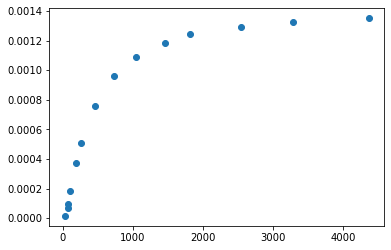

In [9]:
ironCapacitorVoltageX = np.array([24.4,40.8,60,80,100,126,148,182,208,248,268,300,340,372,400,440])

ironCapacitorVoltageY = np.array([20.4,35.2,50.4,64,76,90,100,114,124,136,144,156,168,176,192,200])
ironCapacitorVoltageErrorX = np.array([0.4,0.8,0.8,2,2,2,2,4,4,4,4,4,8,8])
ironCapacitorVoltageErrorY = np.array([0.4,0.8,0.8,2,2,2,2,4,4,4,4,4,8,8])


ironCapacitorVoltageX = np.array([24,72,80,116,196,280,504,798,1134,1590,1988,2784,3586,4772])*2.06/10000
ironCapacitorVoltageY = np.array([20,92,120,236,476,644,960,1218,1382,1498,1578,1638,1678,1712])*2.06/10000



# Plots
n1 = 160
n2 = 150
s = 0.1

ironL = 0.36
ironAc = 0.00087


R = 1e6
C = 5e-10

ironH = [n1 * value / (ironL * s) for value in ironCapacitorVoltageX]
ironB = [R * C * value / (n2 * ironAc) for value in ironCapacitorVoltageY]

plt.scatter(ironH, ironB)

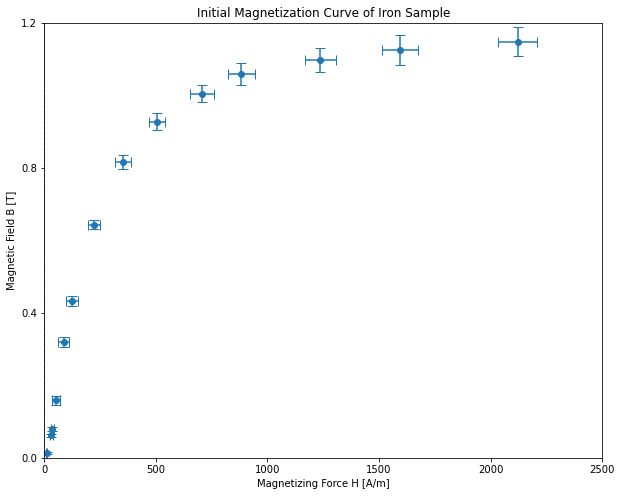

In [36]:
plt.figure(figsize=(10,8))

ironCapacitorVoltageX = np.array([24.4,40.8,60,80,100,126,148,182,208,248,268,300,340,372,400,440])

ironCapacitorVoltageY = np.array([20.4,35.2,50.4,64,76,90,100,114,124,136,144,156,168,176,192,200])
ironCapacitorVoltageErrorX = np.array([0.4,0.8,0.8,2,2,2,2,4,4,4,4,4,8,8])
ironCapacitorVoltageErrorY = np.array([0.4,0.8,0.8,2,2,2,2,4,4,4,4,4,8,8])


ironCapacitorVoltageX = np.array([24,72,80,116,196,280,504,798,1134,1590,1988,2784,3586,4772])/10000
ironCapacitorVoltageY = np.array([20,92,120,236,476,644,960,1218,1382,1498,1578,1638,1678,1712])*1.75*1000/10000
ironCapacitorVoltageErrorX = np.array([0.4,0.8,0.8,2,2.8,3,3,4,4,6,7,8,9,10])/1000*2
ironCapacitorVoltageErrorY = np.array([0.4,0.8,0.8,2,2,2,2,3,3.5,3.5,4.5,5,6,6])*1.75*1000/1000


# Plots
n1 = 160
n2 = 150
s = 0.1

ironL = 0.36
ironAc = 0.00087


R = 1e6
C = 5e-10

ironH = [n1 * value / (ironL * s) for value in ironCapacitorVoltageX]
ironB = [R * C * value / (n2 * ironAc) for value in ironCapacitorVoltageY]
errorIronH = [n1 * value / (ironL * s) for value in ironCapacitorVoltageErrorX]
errorIronB = [R * C * value / (n2 * ironAc) for value in ironCapacitorVoltageErrorY]



plt.errorbar(ironH, ironB, yerr=errorIronB, xerr=errorIronH, fmt='o', capsize=5, label="Peak Voltage Aplitude Measurements")
# plt.scatter(ironH, ironB)



plt.axvline(x=0, color='grey', linestyle='--', linewidth=1)
plt.axhline(y=0, color='grey', linestyle='--', linewidth=1)




plt.title("Initial Magnetization Curve of Iron Sample")
plt.xlabel("Magnetizing Force H [A/m]")
plt.ylabel("Magnetic Field B [T]")
plt.xlim(0,2500)
plt.ylim(0,1.2)
# plt.axis([-6e-01, 6e01, -4e-01, 0.4e01])
plt.xticks(np.linspace(0, 2500, 6))
plt.yticks(np.linspace(0, 1.2, 4))


plt.show()


[8.0e-05 1.6e-04 1.6e-04 4.0e-04 5.6e-04 6.0e-04 6.0e-04 8.0e-04 8.0e-04
 1.2e-03 1.4e-03 1.6e-03 1.8e-03 2.0e-03]
[7.000e-05 1.400e-04 1.400e-04 3.500e-04 3.500e-04 3.500e-04 3.500e-04
 5.250e-04 6.125e-04 6.125e-04 7.875e-04 8.750e-04 1.050e-03 1.050e-03]
[  10.66666667   32.           35.55555556   51.55555556   87.11111111
  124.44444444  224.          354.66666667  504.          706.66666667
  883.55555556 1237.33333333 1593.77777778 2120.88888889]
[0.01340996 0.06168582 0.08045977 0.15823755 0.31915709 0.43180077
 0.64367816 0.81666667 0.92662835 1.00440613 1.05804598 1.09827586
 1.12509579 1.14789272]
[0.35555556 0.71111111 0.71111111 1.77777778 2.48888889 2.66666667
 2.66666667 3.55555556 3.55555556 5.33333333 6.22222222 7.11111111
 8.         8.88888889]
[2.68199234e-07 5.36398467e-07 5.36398467e-07 1.34099617e-06
 1.34099617e-06 1.34099617e-06 1.34099617e-06 2.01149425e-06
 2.34674330e-06 2.34674330e-06 3.01724138e-06 3.35249042e-06
 4.02298851e-06 4.02298851e-06]
1.256637061

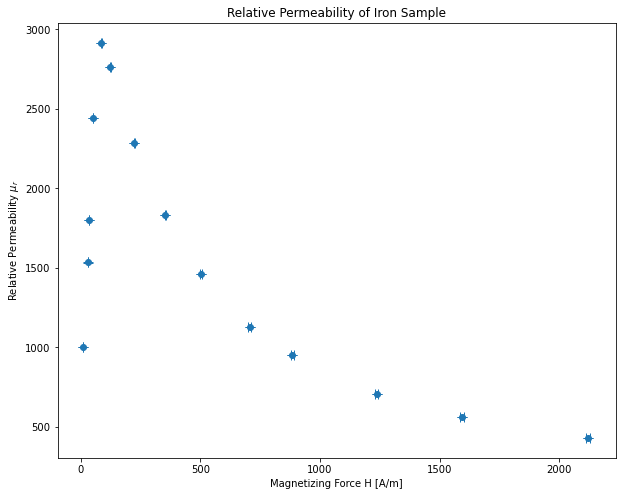

In [39]:
plt.figure(figsize=(10,8))
ironCapacitorVoltageX = np.array([24,72,80,116,196,280,504,798,1134,1590,1988,2784,3586,4772])/10000
ironCapacitorVoltageY = np.array([20,92,120,236,476,644,960,1218,1382,1498,1578,1638,1678,1712])*1.75*1000/10000
ironCapacitorVoltageErrorX = np.array([0.4,0.8,0.8,2,2.8,3,3,4,4,6,7,8,9,10])/10000*2
ironCapacitorVoltageErrorY = np.array([0.4,0.8,0.8,2,2,2,2,3,3.5,3.5,4.5,5,6,6])*1.75/10000
print(ironCapacitorVoltageErrorX)
print(ironCapacitorVoltageErrorY)


# Plots
n1 = 160
n2 = 150
s = 0.1

ironL = 0.36
ironAc = 0.00087


R = 1e6
C = 5e-10

ironH = np.array([n1 * value / (ironL * s) for value in ironCapacitorVoltageX])
ironB = np.array([R * C * value / (n2 * ironAc) for value in ironCapacitorVoltageY])
errorIronH = np.array([n1 * value / (ironL * s) for value in ironCapacitorVoltageErrorX])
errorIronB = np.array([R * C * value / (n2 * ironAc) for value in ironCapacitorVoltageErrorY])

print(ironH)
print(ironB)
print(errorIronH)
print(errorIronB)


freeSpacePerm = 4e-7*np.pi
print(freeSpacePerm)


relPerm = ironB/(ironH*freeSpacePerm)
relPermError = errorIronB/(errorIronH*freeSpacePerm*7)
print(relPermError)
# relPermError = np.array([422.23,397.43,412.17])

plt.errorbar(ironH, relPerm, yerr=relPermError, xerr=errorIronH, fmt='o', capsize=5, label="Peak Voltage Aplitude Measurements")
plt.title("Relative Permeability of Iron Sample")
plt.xlabel("Magnetizing Force H [A/m]")
plt.ylabel(f"Relative Permeability $μ_r$")
# plt.plot(ironH, relPerm)
print(relPerm)

1.2566370614359173e-06


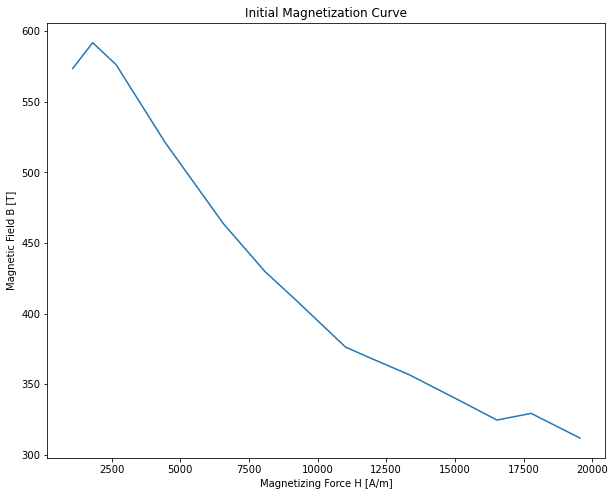

In [12]:
plt.figure(figsize=(10,8))

ironCapacitorVoltageX = np.array([24.4,40.8,60,80,100,126,148,182,208,248,268,300,340,372,400,440])/100

# ironCapacitorVoltageY = np.array([20.4,35.2,50.4,64,76,90,100,114,124,136,144,156,168,176,192,200])*1000/10000
ironCapacitorVoltageY = np.array([20.4,35.2,50.4,64,76,90,100,114,124,136,144,156,168,176,192,200])*1000/100
ironCapacitorVoltageErrorX = np.array([0.4,0.8,0.8,2,2,2,2,4,4,4,4,4,8,8,8,8])/100
ironCapacitorVoltageErrorY = np.array([0.4,0.8,0.8,2,2,2,2,4,4,4,4,4,8,8,8,8])*1000/100


# ironCapacitorVoltageX = np.array([24,72,80,116,196,280,504,798,1134,1590,1988,2784,3586,4772])*2.06/10000
# ironCapacitorVoltageY = np.array([20,92,120,236,476,644,960,1218,1382,1498,1578,1638,1678,1712])*2.06*1000/10000
# ironCapacitorVoltageErrorX = np.array([0.4,0.8,0.8,2,2.8,3,2,3,3,6,7,8,9,10])*2.06/1000*2
# ironCapacitorVoltageErrorY = np.array([0.4,0.8,0.8,2,2,2,2,3,3.5,3.5,4.5,5,6,6])*2.06*1000/1000


# Plots
n1 = 160
n2 = 150
s = 0.1

ironL = 0.36
ironAc = 0.00087


R = 1e6
C = 5e-10

ironH = np.array([n1 * value / (ironL * s) for value in ironCapacitorVoltageX])
ironB = np.array([R * C * value / (n2 * ironAc) for value in ironCapacitorVoltageY])
errorIronH = np.array([n1 * value / (ironL * s) for value in ironCapacitorVoltageErrorX])
errorIronB = np.array([R * C * value / (n2 * ironAc) for value in ironCapacitorVoltageErrorY])


freeSpacePerm = 4e-7*np.pi
print(freeSpacePerm)

den = ironH*freeSpacePerm
relPerm = ironB/(den)

plt.plot(ironH, relPerm)
plt.title("Initial Magnetization Curve")
plt.xlabel("Magnetizing Force H [A/m]")
plt.ylabel("Magnetic Field B [T]")
# plt.xlim(0,5000)
# plt.ylim(0,1.45)
# # plt.axis([-6e-01, 6e01, -4e-01, 0.4e01])
# plt.xticks(np.linspace(0, 5000, 5))
# plt.yticks(np.linspace(0, 1.5, 4))


plt.show()


## Part C: Qualitative investigation of power loss

### Procedure - Part 9
when we finished taking samples for the carbon steel, we touched the sample and observed it had heated up due to energy losses.
Rough estimate of what wattage bulb we felt would produce that much heat:




#### We turned off the variac without reducing the voltage to zero.
Gently try lifting the iron sample.
The iron block is still magnetized strongly even when the variac is turned off. The block is warm
#### We turned the variac back on and reduced the voltage to zero
we noticed that now the block is not magnetized anymore and easy to remove.
If we have it at magnetized voltage (30%) then turn it off and move it to zero, the block is still magnetized strongly


The same thing happens to both samples 

#### For the heat comparison for the light bulb to the sample
In our humble opinions we felt that the iron sample was substantially warmer than the 25 watt light bulb but of course this is merely an opinion.

for the difference in heat of the iron vs steel, the steel was warmer then the iron when tested but interestingly enough, the actual yoke got warm when the iron was being magnetized but the steel being magnetized, the yoke was substantially lower in heat.

The yokes are less hot then the steel, and the middle gets much warmer then the sides for both sample


##### length should be used to determine the volume to use for energy loss calculations
cross sectional area



## Part D: Apparatus Measurements

### Procedure - Part 10
we then took measurements of the:
##### - The cross-sectional area of the samples. This is simply the cross-section of the bars placed on the yoke.
    - Cross sectional area of steel 28x27 mm
    - Cross sectional area of iron 30x29 mm

##### - The magnetic length of the samples (rough estimate of the length of the magnetic loop)
    - the iron length is roughly 36 +/- 1 centimeters for iron (10.5cm tall and 7.5cm across)
    - the steel length is roughly 7.5 +/- 0.5 centimeters for iron
    
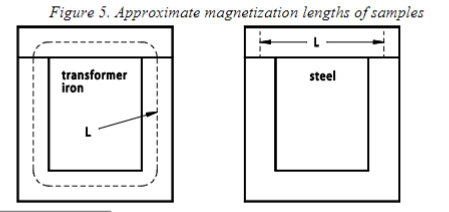

## Part E: Investigate effect of air gap and eddy currents

### Procedure - Part 11
we experimented with placing the plastic and copper spacers between the transformer iron and the yoke. 
Introducing these spacers caused a change in the shape of the hysteresis loop. The plastic spacer acted as an air gap, causing the same magnetizing current to produce much less hysteresis.
In general, the larger the air gap, the better the linearity. 
The copper spacer is available to show the effects of eddy currents (used in magnetic brakes). 
Saved traces for each type of spacer



#### Plastic spacer
- a lot louder than without spacer
- hysteresis is much more linear than normal
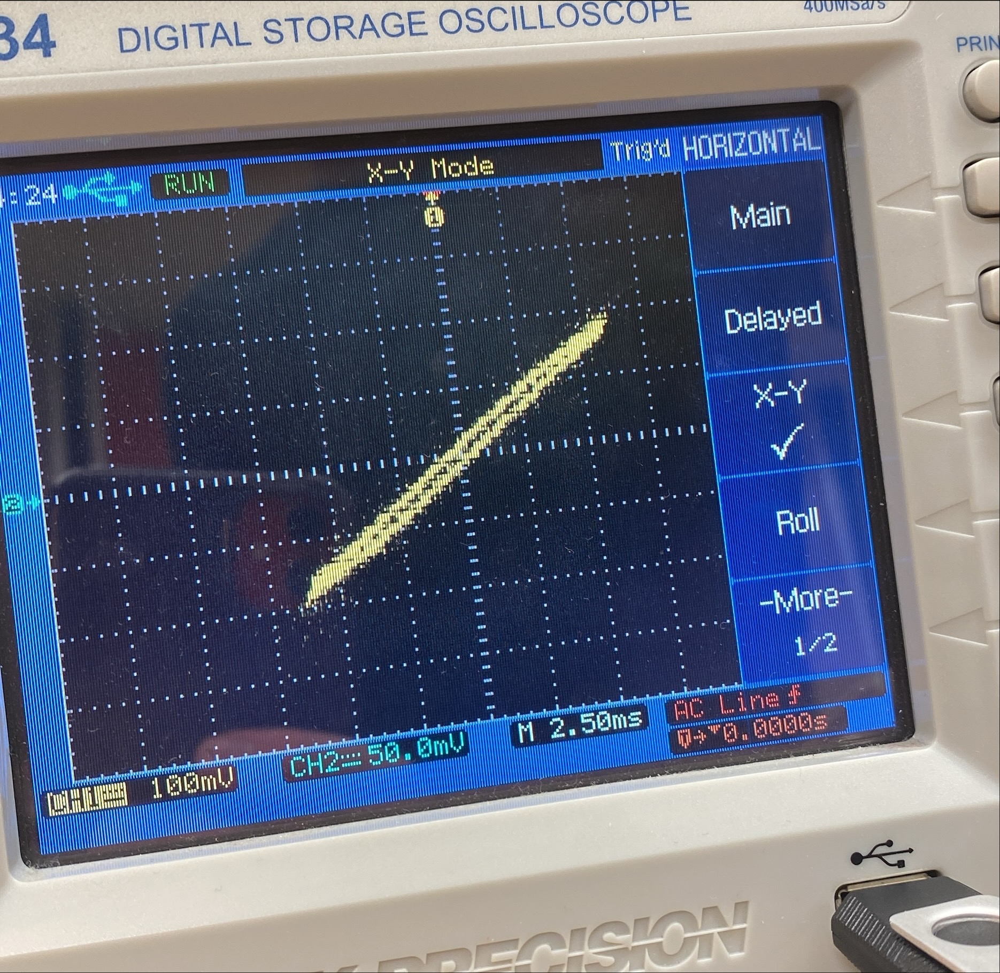

#### Copper Spacer
-  a lot louder than without spacer
- hysteresis is much more circular than normal
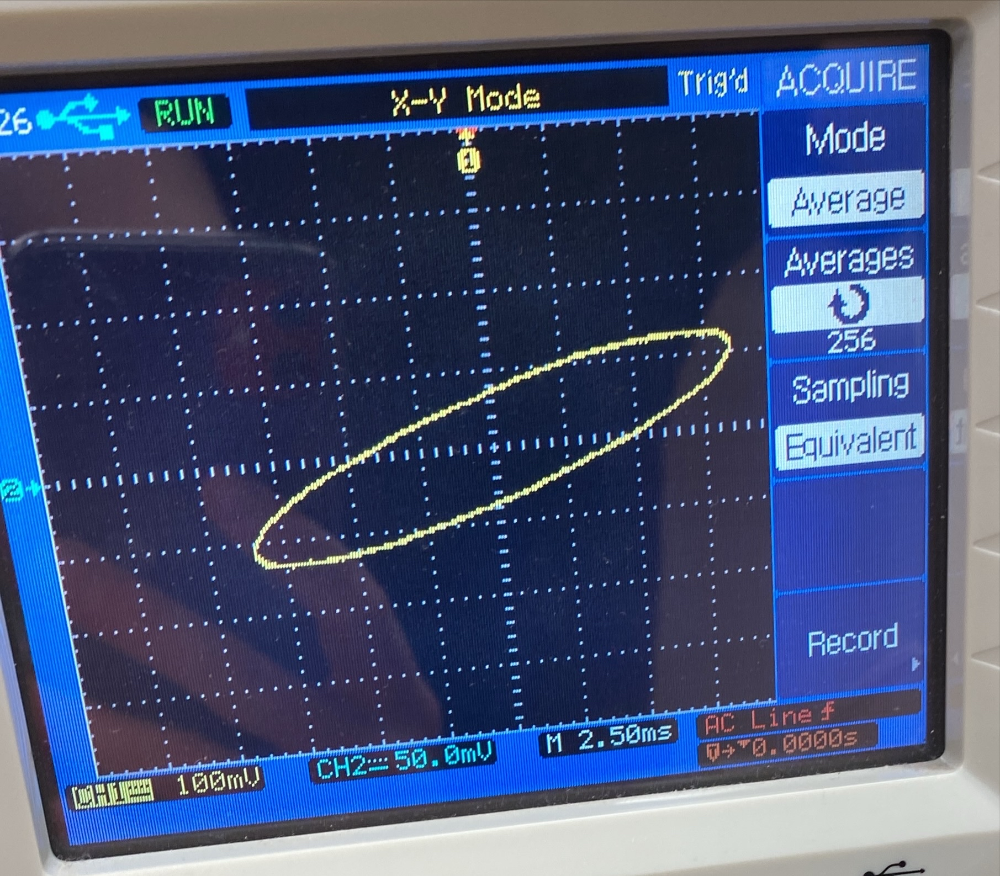

In [13]:
import pandas as pd

# Replace 'your_file.csv' and 'your_column_name' with the actual path and column name
df = pd.read_csv(r'C:\Users\ben\Desktop\Queens Year 2\Semester 2\ENPH 253\File3HysteresisIronPlasticSpacer.CSV')
# column_list = df['A'].tolist()
plasticA = df.iloc[0:,0].tolist()
plasticA.pop(0)
plasticColumnA = list(map(float, plasticA))

plasticB = df.iloc[0:,1].tolist()
plasticB.pop(0)
plasticColumnB = list(map(float, plasticB))

plasticC = df.iloc[0:,2].tolist()
plasticC.pop(0)
plasticColumnC = list(map(float, plasticC))


# Replace 'your_file.csv' and 'your_column_name' with the actual path and column name
df1 = pd.read_csv(r'C:\Users\ben\Desktop\Queens Year 2\Semester 2\ENPH 253\File4HysteresisIronCopperSpacer.CSV')
# column_list = df['A'].tolist()


copperA = df1.iloc[0:,0].tolist()
copperA.pop(0)
copperColumnA = list(map(float, copperA))

copperB = df1.iloc[0:,1].tolist()
copperB.pop(0)
copperColumnB = list(map(float, copperB))

copperC = df1.iloc[0:,2].tolist()
copperC.pop(0)
copperColumnC = list(map(float, copperC))
# Display the resulting list

# plt.scatter(ironColumnB, ironColumnC, s=2)
# plt.scatter(steelColumnB, steelColumnC, s=2)

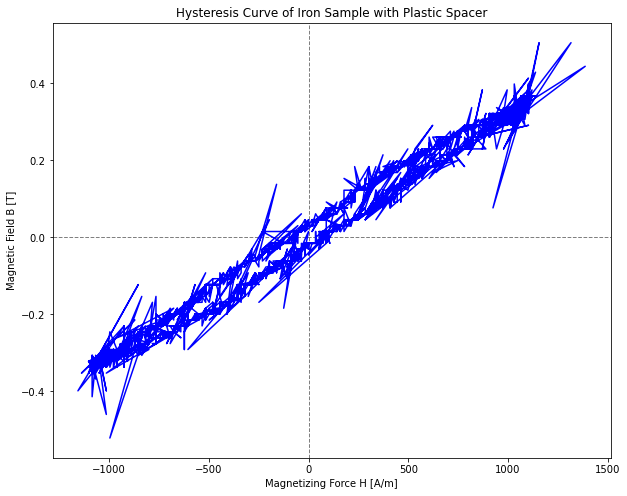

In [56]:
# Plots
n1 = 160
n2 = 150
s = 0.1

ironL = 0.36
ironAc = 0.00087

steelL = 0.075
steelAc = 0.00076

R = 1e6
C = 5e-10

plasticH = [n1 * value / (ironL * s) for value in plasticColumnB]
plasticB = [R * C * value *1000/ (n2 * ironAc) for value in plasticColumnC]
copperH = [n1 * value/ (ironL * s) for value in copperColumnB]
copperB = [R * C * value *1000/ (n2 * steelAc) for value in copperColumnC]

plt.figure(figsize=(10,8))

plt.axvline(x=0, color='grey', linestyle='--', linewidth=1)
plt.axhline(y=0, color='grey', linestyle='--', linewidth=1)


plt.plot(plasticH, plasticB, label="Plastic", color='blue')



# plt.scatter(-1479.11,0, label='Carbon Steel Coercive Force ($H_C$)', marker='o', facecolor='none', color='darkred',linewidth = 2, s=50, zorder=2)
# plt.scatter(0,0.11023, label='Carbon Steel Remanence Force ($B_r$)', marker='x', color='darkred',linewidth = 2, s=50, zorder=2)

plt.title("Hysteresis Curve of Iron Sample with Plastic Spacer")
plt.xlabel("Magnetizing Force H [A/m]")
plt.ylabel("Magnetic Field B [T]")
# plt.xlim(-0.5,0.5)
# plt.ylim(-0.5,0.5)
# plt.axis([-6e-01, 6e01, -4e-01, 0.4e01])
# plt.xticks(np.linspace(-0.6, 0.6, 5))
# plt.yticks(np.linspace(-0.4, 0.4, 5))


# plt.legend()

plt.show()

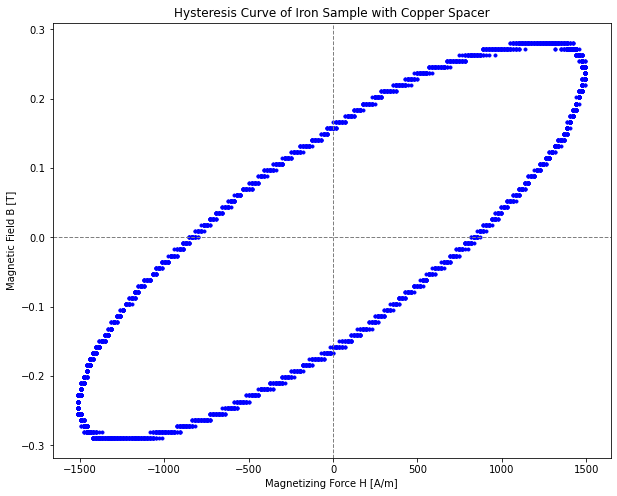

In [51]:

# Plots
n1 = 160
n2 = 150
s = 0.1

ironL = 0.36
ironAc = 0.00087

steelL = 0.075
steelAc = 0.00076

R = 1e6
C = 5e-10

plasticH = [n1 * value / (ironL * s) for value in plasticColumnB]
plasticB = [R * C * value *1000/ (n2 * ironAc) for value in plasticColumnC]
copperH = [n1 * value/ (ironL * s) for value in copperColumnB]
copperB = [R * C * value *1000/ (n2 * steelAc) for value in copperColumnC]

plt.figure(figsize=(10,8))

plt.axvline(x=0, color='grey', linestyle='--', linewidth=1)
plt.axhline(y=0, color='grey', linestyle='--', linewidth=1)


plt.scatter(copperH, copperB, label="Carbon Steel", s=10, linewidth=0.8, color='blue')



# plt.scatter(-1479.11,0, label='Carbon Steel Coercive Force ($H_C$)', marker='o', facecolor='none', color='darkred',linewidth = 2, s=50, zorder=2)
# plt.scatter(0,0.11023, label='Carbon Steel Remanence Force ($B_r$)', marker='x', color='darkred',linewidth = 2, s=50, zorder=2)

plt.title("Hysteresis Curve of Iron Sample with Copper Spacer")
plt.xlabel("Magnetizing Force H [A/m]")
plt.ylabel("Magnetic Field B [T]")
# plt.xlim(-0.5,0.5)
# plt.ylim(-0.5,0.5)
# plt.axis([-6e-01, 6e01, -4e-01, 0.4e01])
# plt.xticks(np.linspace(-0.6, 0.6, 5))
# plt.yticks(np.linspace(-0.4, 0.4, 5))


# plt.legend()

plt.show()

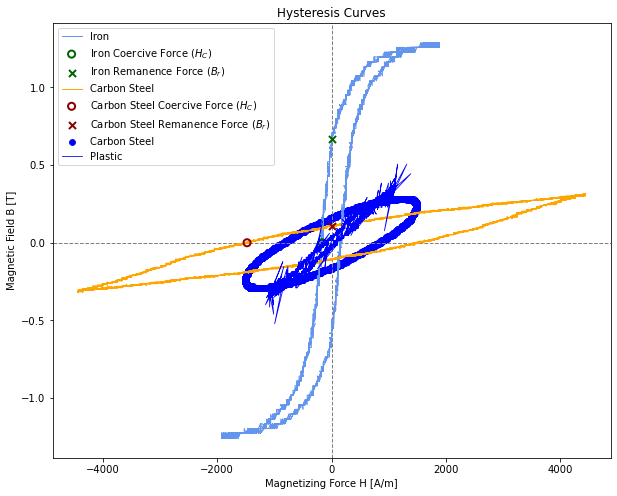

In [29]:
# Plots
n1 = 160
n2 = 150
s = 0.1

ironL = 0.36
ironAc = 0.00087

steelL = 0.075
steelAc = 0.00076

R = 1e6
C = 5e-10

ironH = [n1 * value / (ironL * s) for value in ironColumnB]
ironB = [R * C * value *1000/ (n2 * ironAc) for value in ironColumnC]
steelH = [n1 * value/ (steelL * s) for value in steelColumnB]
steelB = [R * C * value *1000/ (n2 * steelAc) for value in steelColumnC]

plt.figure(figsize=(10,8))

plt.axvline(x=0, color='grey', linestyle='--', linewidth=1)
plt.axhline(y=0, color='grey', linestyle='--', linewidth=1)


plt.plot(ironH, ironB, label="Iron", linewidth=1, color='cornflowerblue')
plt.scatter(-166,0, label='Iron Coercive Force ($H_C$)', marker='o', facecolor='none', color='darkgreen',linewidth = 2, s=50, zorder=2)
plt.scatter(0,0.67, label='Iron Remanence Force ($B_r$)', marker='x', color='darkgreen',linewidth = 2, s=50, zorder=2)

plt.plot(steelH, steelB, label="Carbon Steel", linewidth=1, color='orange')
plt.scatter(-1479.11,0, label='Carbon Steel Coercive Force ($H_C$)', marker='o', facecolor='none', color='darkred',linewidth = 2, s=50, zorder=2)
plt.scatter(0,0.11023, label='Carbon Steel Remanence Force ($B_r$)', marker='x', color='darkred',linewidth = 2, s=50, zorder=2)

plt.scatter(copperH, copperB, label="Carbon Steel", linewidth=0.8, color='blue')
plt.plot(plasticH, plasticB, label="Plastic", linewidth=0.8, color='blue')


plt.title("Hysteresis Curves")
plt.xlabel("Magnetizing Force H [A/m]")
plt.ylabel("Magnetic Field B [T]")
# plt.xlim(-0.5,0.5)
# plt.ylim(-0.5,0.5)
# plt.axis([-6e-01, 6e01, -4e-01, 0.4e01])
# plt.xticks(np.linspace(-0.6, 0.6, 5))
# plt.yticks(np.linspace(-0.4, 0.4, 5))


plt.legend()

plt.show()


# print(f"Resistance: {linReg1[1]}, Inductance: {linReg1[0]}")